# KNN

In [2]:
import mglearn
import matplotlib.pyplot as plt
import numpy as np
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
import pandas as pd
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from sklearn.metrics import matthews_corrcoef
from sklearn.metrics import accuracy_score

In [3]:
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import f1_score

In [71]:
datafile= pd.read_csv("/home/local/BHRI/agarg/06/datasets/features.csv")

# print(datafile.keys())
y_cols= ["pepClass"]
x_cols= ['aindex', 'autocovariance', 'autocorrelation', 'BLOSUM1',
       'BLOSUM2', 'BLOSUM3', 'BLOSUM4', 'BLOSUM5', 'BLOSUM6', 'BLOSUM7',
       'BLOSUM8', 'BLOSUM9', 'BLOSUM10', 'boman', 'charge', 'crosscovariance',
       'PP1', 'PP2', 'PP3', 'F1', 'F2', 'F3', 'F4', 'F5', 'F6', 'hmoment',
       'hydrophobicity', 'instaindex', 'KF1', 'KF2', 'KF3', 'KF4', 'KF5',
       'KF6', 'KF7', 'KF8', 'KF9', 'KF10', 'lengthpep', 'MSWHIM1', 'MSWHIM2',
       'MSWHIM3', 'mw', 'pI', 'ProtFP1', 'ProtFP2', 'ProtFP3', 'ProtFP4',
       'ProtFP5', 'ProtFP6', 'ProtFP7', 'ProtFP8', 'ST1', 'ST2', 'ST3', 'ST4',
       'ST5', 'ST6', 'ST7', 'ST8', 'T1', 'T2', 'T3', 'T4', 'T5', 'VHSE1',
       'VHSE2', 'VHSE3', 'VHSE4', 'VHSE5', 'VHSE6', 'VHSE7', 'VHSE8', 'Z1',
       'Z2', 'Z3', 'Z4', 'Z5', 'column_tiny_number', 'column_tiny_percentage',
       'column_Small_number', 'column_Small_percentage',
       'column_Aliphatic_number', 'column_Aliphatic_percentage',
       'column_Aromatic_number', 'column_Aromatic_percentage',
       'column_NonPolar_number', 'column_NonPolar_percentage',
       'column_Polar_number', 'column_Polar_percentage',
       'column_Charged_number', 'column_Charged_percentage',
       'column_Basic_number', 'column_Basic_percentage',
       'column_Acidic_number', 'column_Acidic_percentage']
x_selected= ["column_Acidic_percentage", "PP3"]
X= datafile[x_cols].values
y= datafile[y_cols].values

X=np.nan_to_num(X)
y=np.nan_to_num(y)

y=y.ravel()
y=pd.factorize(y)[0]

In [72]:
X_train, X_test, y_train, y_test= train_test_split(X,y,random_state=0)

In [73]:
# Feature Scaling

sc_X= StandardScaler()
X_train= sc_X.fit_transform(X_train)
X_test= sc_X.transform(X_test)

In [74]:
import math
math.sqrt(len(y_test))

62.52999280345393

In [75]:
clf=KNeighborsClassifier(n_neighbors=63, p=2, metric= "euclidean")


In [76]:
clf.fit(X_train, y_train)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='euclidean',
           metric_params=None, n_jobs=None, n_neighbors=63, p=2,
           weights='uniform')

In [77]:
y_pred= clf.predict(X_test)
y_pred

array([0, 0, 0, ..., 0, 0, 0])

In [79]:
#Evaluate model

cm= confusion_matrix(y_test, y_pred)
cm

array([[3175,  134],
       [ 369,  232]])

In [80]:
print(f1_score(y_test, y_pred))

0.4798345398138573


In [81]:
print(accuracy_score(y_test, y_pred))

0.8713554987212276


ValueError: query data dimension must match training data dimension

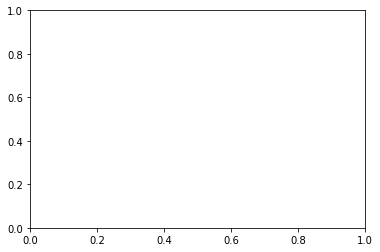

In [85]:
mglearn.plots.plot_2d_separator(clf, X_train, fill=True)
ax.set_xlabel("column_Acidic_percentage")
ax.set_ylabel("PP3")

# knn visualization

ValueError: query data dimension must match training data dimension

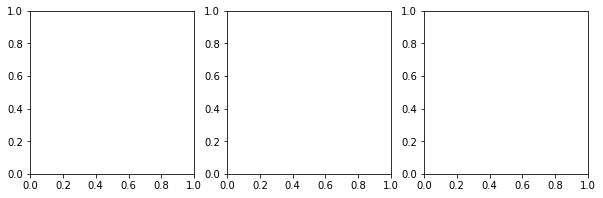

In [33]:
fig, axes= plt.subplots(1,3, figsize=(10,3))

for n_neighbors, ax in zip([1,3,9], axes):
    clf= KNeighborsClassifier(n_neighbors= n_neighbors).fit(X_train, y_train)
    mglearn.plots.plot_2d_separator(clf, X_train, fill=True, ax=ax, alpha=0.4)
    plot_2d_separator(clf, X, fill=True)
#     mglearn.discrete_scatter(X[:,0], X[:,1], y, ax= ax)
    ax.set_title("{} neighbors".format(n_neighbors))
    ax.set_xlabel("column_Acidic_percentage")
    ax.set_ylabel("PP3")

# axes[0].legend(loc=3)


# knn n_neighbors/Accuracy

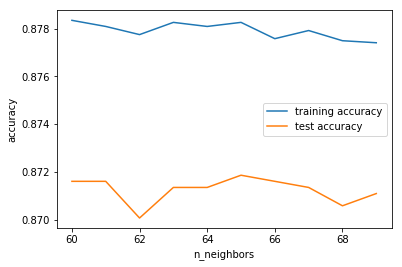

In [82]:
training_accuracy= []
test_accuracy=[]

neighbors_setting= range(60,70)

for n_neighbors in neighbors_setting:
    clf=KNeighborsClassifier(n_neighbors=n_neighbors).fit(X_train, y_train)
    #training set accuracy
    training_accuracy.append(clf.score(X_train, y_train))
    #generalizaton accuracy
    test_accuracy.append(clf.score(X_test, y_test))
    
plt.plot(neighbors_setting, training_accuracy, label= "training accuracy")
plt.plot(neighbors_setting, test_accuracy, label= "test accuracy")
plt.ylabel("accuracy")
plt.xlabel("n_neighbors")
plt.legend()
# plt.show() 

# knn Training Metrics

In [9]:
y_pred= clf.predict(X_test)
y_true= y_test

results= confusion_matrix(y_true, y_pred)

print(results)

[[3173  136]
 [ 458  143]]


Confusion matrix, without normalization
[[3173  136]
 [ 458  143]]
Normalized confusion matrix
[[0.96 0.04]
 [0.76 0.24]]


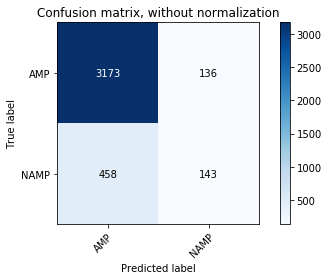

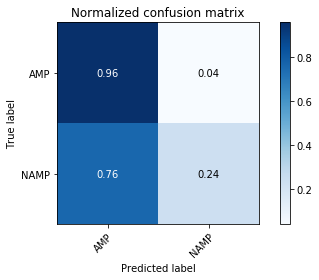

In [10]:
# #import some data to play with
# iris = datasets.load_iris()
# X = iris.data
# y = iris.target
class_names =["AMP", "NAMP"]

# # Split the data into a training set and a test set
# X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)

# # Run classifier, using a model that is too regularized (C too low) to see
# # the impact on the results
# classifier = svm.SVC(kernel='linear', C=0.01)
# y_pred = classifier.fit(X_train, y_train).predict(X_test)


def plot_confusion_matrix(y_true, y_pred, classes,
                          normalize=False,
                          title=None,
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if not title:
        if normalize:
            title = 'Normalized confusion matrix'
        else:
            title = 'Confusion matrix, without normalization'

    # Compute confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    # Only use the labels that appear in the data
#     classes = classes[unique_labels(y_true, y_pred)]
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    fig, ax = plt.subplots()
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
    ax.figure.colorbar(im, ax=ax)
    # We want to show all ticks...
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           # ... and label them with the respective list entries
           xticklabels=classes, yticklabels=classes,
           title=title,
           ylabel='True label',
           xlabel='Predicted label')

    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
             rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(j, i, format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()
    return ax


np.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
plot_confusion_matrix(y_test, y_pred, classes=class_names, title='Confusion matrix, without normalization')

# Plot normalized confusion matrix
plot_confusion_matrix(y_test, y_pred, classes=class_names, normalize=True, title='Normalized confusion matrix')

plt.show()

In [11]:
matthews_result= matthews_corrcoef(y_true, y_pred)
matthews_result

0.27578875936963215

# knn cdhit sequences

In [12]:
cdhit_datafile= pd.read_csv("/home/local/BHRI/agarg/06/datasets/features.csv")

# print(datafile.keys())
y_cols= ["pepClass"]
x_cols= ['aindex', 'autocovariance', 'autocorrelation', 'BLOSUM1',
       'BLOSUM2', 'BLOSUM3', 'BLOSUM4', 'BLOSUM5', 'BLOSUM6', 'BLOSUM7',
       'BLOSUM8', 'BLOSUM9', 'BLOSUM10', 'boman', 'charge', 'crosscovariance',
       'PP1', 'PP2', 'PP3', 'F1', 'F2', 'F3', 'F4', 'F5', 'F6', 'hmoment',
       'hydrophobicity', 'instaindex', 'KF1', 'KF2', 'KF3', 'KF4', 'KF5',
       'KF6', 'KF7', 'KF8', 'KF9', 'KF10', 'lengthpep', 'MSWHIM1', 'MSWHIM2',
       'MSWHIM3', 'mw', 'pI', 'ProtFP1', 'ProtFP2', 'ProtFP3', 'ProtFP4',
       'ProtFP5', 'ProtFP6', 'ProtFP7', 'ProtFP8', 'ST1', 'ST2', 'ST3', 'ST4',
       'ST5', 'ST6', 'ST7', 'ST8', 'T1', 'T2', 'T3', 'T4', 'T5', 'VHSE1',
       'VHSE2', 'VHSE3', 'VHSE4', 'VHSE5', 'VHSE6', 'VHSE7', 'VHSE8', 'Z1',
       'Z2', 'Z3', 'Z4', 'Z5', 'column_tiny_number', 'column_tiny_percentage',
       'column_Small_number', 'column_Small_percentage',
       'column_Aliphatic_number', 'column_Aliphatic_percentage',
       'column_Aromatic_number', 'column_Aromatic_percentage',
       'column_NonPolar_number', 'column_NonPolar_percentage',
       'column_Polar_number', 'column_Polar_percentage',
       'column_Charged_number', 'column_Charged_percentage',
       'column_Basic_number', 'column_Basic_percentage',
       'column_Acidic_number', 'column_Acidic_percentage']
x_selected= ["column_Acidic_percentage", "PP3"]
X2= cdhit_datafile[x_selected].values
y2= cdhit_datafile[y_cols].values

X2=np.nan_to_num(X2)
y2=np.nan_to_num(y2)

y2=y2.ravel()

In [13]:
X_train2, X_test2, y_train2, y_test2= train_test_split(X2,y2,random_state=0)
clf2=KNeighborsClassifier(n_neighbors=1)

clf2.fit(X_train2, y_train2)

print("Test set prediction: {}".format(clf2.predict(X_test2)))
print("Test set accuracy: {:.2f}". format(clf2.score(X_test2, y_test2)))

Test set prediction: ['AMP' 'AMP' 'AMP' ... 'NAMP' 'NAMP' 'AMP']
Test set accuracy: 0.84


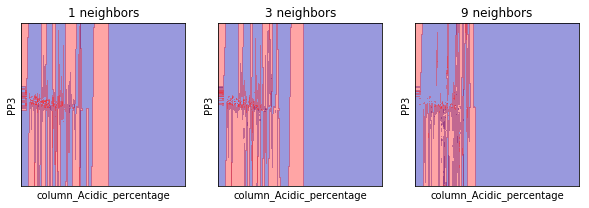

In [14]:
fig2, axes2= plt.subplots(1,3, figsize=(10,3))

for n_neighbors, ax in zip([1,3,9], axes2):
    clf2= KNeighborsClassifier(n_neighbors= n_neighbors).fit(X2, y2)
    mglearn.plots.plot_2d_separator(clf2, X_train2, fill=True, ax=ax, alpha=0.4)
#     mglearn.discrete_scatter(X[:,0], X[:,1], y, ax= ax)
    ax.set_title("{} neighbors".format(n_neighbors))
    ax.set_xlabel("column_Acidic_percentage")
    ax.set_ylabel("PP3")

# axes[0].legend(loc=3)


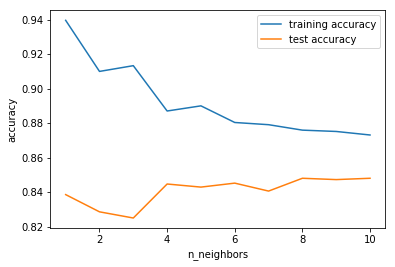

In [15]:
training_accuracy= []
test_accuracy=[]

neighbors_setting= range(1,11)

for n_neighbors in neighbors_setting:
    clf=KNeighborsClassifier(n_neighbors=n_neighbors).fit(X_train2, y_train2)
    #training set accuracy
    training_accuracy.append(clf.score(X_train2, y_train2))
    #generalizaton accuracy
    test_accuracy.append(clf.score(X_test2, y_test2))
    
plt.plot(neighbors_setting, training_accuracy, label= "training accuracy")
plt.plot(neighbors_setting, test_accuracy, label= "test accuracy")
plt.ylabel("accuracy")
plt.xlabel("n_neighbors")
plt.legend()

In [16]:
y_pred2= clf.predict(X_test2)
y_true2= y_test2

results2= confusion_matrix(y_true2, y_pred2)

print(results2)

[[3173  136]
 [ 458  143]]


Confusion matrix, without normalization
[[3173  136]
 [ 458  143]]
Normalized confusion matrix
[[0.96 0.04]
 [0.76 0.24]]


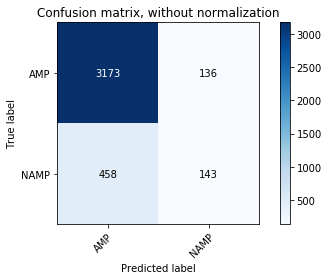

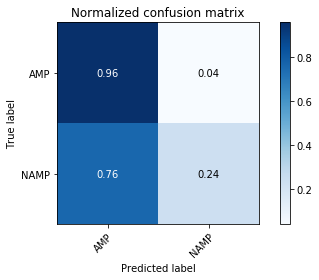

In [17]:
# #import some data to play with
# iris = datasets.load_iris()
# X = iris.data
# y = iris.target
class_names =["AMP", "NAMP"]

# # Split the data into a training set and a test set
# X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)

# # Run classifier, using a model that is too regularized (C too low) to see
# # the impact on the results
# classifier = svm.SVC(kernel='linear', C=0.01)
# y_pred = classifier.fit(X_train, y_train).predict(X_test)


def plot_confusion_matrix(y_true2, y_pred2, classes,
                          normalize=False,
                          title=None,
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if not title:
        if normalize:
            title = 'Normalized confusion matrix'
        else:
            title = 'Confusion matrix, without normalization'

    # Compute confusion matrix
    cm = confusion_matrix(y_true2, y_pred2)
    # Only use the labels that appear in the data
#     classes = classes[unique_labels(y_true, y_pred)]
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    fig, ax = plt.subplots()
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
    ax.figure.colorbar(im, ax=ax)
    # We want to show all ticks...
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           # ... and label them with the respective list entries
           xticklabels=classes, yticklabels=classes,
           title=title,
           ylabel='True label',
           xlabel='Predicted label')

    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
             rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(j, i, format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()
    return ax


np.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
plot_confusion_matrix(y_test2, y_pred2, classes=class_names, title='Confusion matrix, without normalization')

# Plot normalized confusion matrix
plot_confusion_matrix(y_test2, y_pred2, classes=class_names, normalize=True, title='Normalized confusion matrix')

plt.show()

# SVC

In [41]:
from sklearn import svm

In [42]:
X
y

array(['AMP', 'AMP', 'AMP', ..., 'NAMP', 'NAMP', 'NAMP'], dtype=object)

In [43]:
clf= svm.SVC(kernel= "linear", C=1.0)
clf.fit(X_train,y_train)

SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto_deprecated',
  kernel='linear', max_iter=-1, probability=False, random_state=None,
  shrinking=True, tol=0.001, verbose=False)

In [44]:
print(clf.predict(X_test))


['AMP' 'AMP' 'AMP' ... 'AMP' 'AMP' 'AMP']


In [45]:
print("Test set accuracy: {:.2f}". format(clf.score(X_test, y_test)))


Test set accuracy: 0.85


In [46]:
y2_num= list()
for i in range(len(y2)):
    if y2[i]=="AMP":
        y2_num.append(1)
    else:
        y2_num.append(0)
y2_num

[1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,


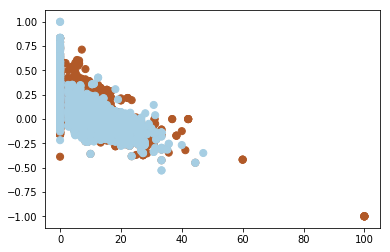

In [48]:
plt.scatter(X2[:,0], X2[:, 1], c=y2_num, s=50, cmap=plt.cm.Paired)

/home/local/BHRI/agarg/anaconda3/lib/python3.7/site-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


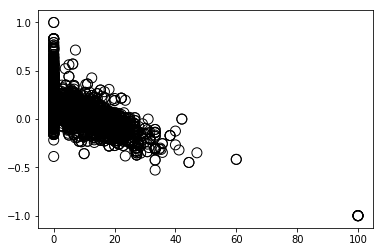

In [49]:

# plot the decision function
ax = plt.gca()
xlim = ax.get_xlim()
ylim = ax.get_ylim()

# create grid to evaluate model
xx = np.linspace(xlim[0], xlim[1], 30)
yy = np.linspace(ylim[0], ylim[1], 30)
YY, XX = np.meshgrid(yy, xx)
xy = np.vstack([XX.ravel(), YY.ravel()]).T
Z = clf.decision_function(xy).reshape(XX.shape)

# plot decision boundary and margins
ax.contour(XX, YY, Z, colors='k', levels=[-1, 0, 1], alpha=0.5,
           linestyles=['--', '-', '--'])
# plot support vectors
ax.scatter(clf.support_vectors_[:, 0], clf.support_vectors_[:, 1], s=100,
           linewidth=1, facecolors='none', edgecolors='k')
plt.show()

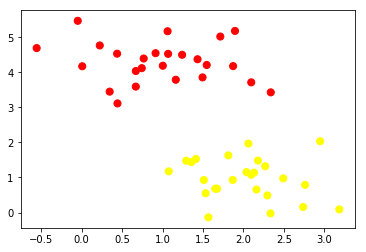

In [50]:


from sklearn.datasets.samples_generator import make_blobs
X, y = make_blobs(n_samples=50, centers=2,
                  random_state=0, cluster_std=0.60)
plt.scatter(X[:, 0], X[:, 1], c=y, s=50, cmap='autumn');



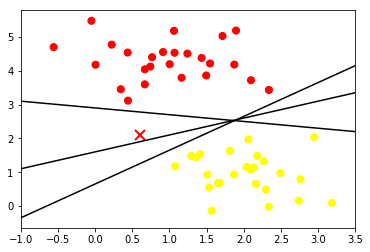

In [51]:


xfit = np.linspace(-1, 3.5)
plt.scatter(X[:, 0], X[:, 1], c=y, s=50, cmap='autumn')
plt.plot([0.6], [2.1], 'x', color='red', markeredgewidth=2, markersize=10)

for m, b in [(1, 0.65), (0.5, 1.6), (-0.2, 2.9)]:
    plt.plot(xfit, m * xfit + b, '-k')

plt.xlim(-1, 3.5);





# cdhit sequences

In [52]:
clf2= svm.SVC(kernel= "linear", C=1.0)
clf2.fit(X_train2, y_train2)

SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto_deprecated',
  kernel='linear', max_iter=-1, probability=False, random_state=None,
  shrinking=True, tol=0.001, verbose=False)

In [53]:
print(clf2.predict(X_test2))

['AMP' 'AMP' 'AMP' ... 'AMP' 'AMP' 'AMP']


In [54]:
print("Test set accuracy: {:.2f}".format(clf2.score(X_test2, y_test2)))

Test set accuracy: 0.85


# RANDOM FOREST

In [86]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import roc_auc_score
from sklearn.ensemble import RandomForestClassifier

In [19]:
tree= DecisionTreeClassifier(random_state=0)
tree.fit(X_train, y_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=0,
            splitter='best')

In [20]:
print("model accuracy: {:.2f}".format(tree.score(X_test, y_test)))

model accuracy: 0.83


In [21]:
# Model (can also use single decision tree)
model = RandomForestClassifier(n_estimators=10)

# Train
model.fit(X_train, y_train)
# Extract single tree
estimator = model.estimators_[5]

feature_names= x_selected
classes=["AMP", "NAMP"]

from sklearn.tree import export_graphviz
# Export as dot file
export_graphviz(estimator, out_file='tree1.dot', 
                feature_names = feature_names,
                class_names = classes,
                rounded = True, proportion = False, 
                precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)
from subprocess import call
call(['dot', '-Tpng', 'tree1.dot', '-o', 'tree1.png', '-Gdpi=600'])

# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'tree1.png')

In [22]:
model= RandomForestClassifier(n_estimators=1000,
                             bootstrap= True,
                             max_features= 'sqrt')

model.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='sqrt', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=1000, n_jobs=None,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [23]:
#roc_auc score for random forest
rf_predictions= model.predict(X_test)
rf_predictions

array(['AMP', 'AMP', 'AMP', ..., 'NAMP', 'AMP', 'AMP'], dtype=object)

In [24]:
rf_probs= model.predict_proba(X_test)[:,1]
rf_probs

array([0.05, 0.02, 0.07, ..., 0.96, 0.49, 0.04])

In [25]:
roc_value= roc_auc_score(y_test, rf_probs)
roc_value

0.8314861550885524

In [26]:
#roc_auc score for decision tree:
rf_predictions1=tree.predict(X_test)
rf_probs1= tree.predict_proba(X_test)[:, 1]

In [27]:
roc_value1= roc_auc_score(y_test, rf_probs1)
roc_value1

0.7805820258268052

In [28]:
model.predict_proba(X_test)

array([[0.95, 0.05],
       [0.98, 0.02],
       [0.93, 0.07],
       ...,
       [0.04, 0.96],
       [0.51, 0.49],
       [0.96, 0.04]])

In [29]:
model.predict(X_test)[-3:]

array(['NAMP', 'AMP', 'AMP'], dtype=object)

In [30]:
y_test[-3:]

array(['NAMP', 'AMP', 'AMP'], dtype=object)

In [31]:
y_pred3= model.predict(X_test)
y_true3= y_test

results3= confusion_matrix(y_true3, y_pred3)

print(results3)

[[3045  264]
 [ 333  268]]


In [32]:
print(type(results3))

<class 'numpy.ndarray'>


In [33]:
pd.crosstab(y_test, model.predict(X_test), rownames=['Actual Species'],colnames= ["Predicted Species"])

Predicted Species,AMP,NAMP
Actual Species,,
AMP,3045,264
NAMP,333,268


In [34]:
accuracy= accuracy_score(y_true3, y_pred3)
accuracy

0.8473145780051151

# decision tree visualization of a random forest

In [35]:
# Extract single tree
# estimator = model.estimators_[5]

from sklearn.tree import export_graphviz
# Export as dot file
export_graphviz(estimator, out_file='tree2.dot', 
                feature_names = x_selected,
                class_names =classes,
                rounded = True, proportion = False, 
                precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)
from subprocess import call
call(['dot', '-Tpng', 'tree2.dot', '-o', 'tree2.png', '-Gdpi=600'])

# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'tree2.png')

# Feature Importance using Random Forest

In [36]:
X= datafile[x_cols].values
y= datafile[y_cols].values

X=np.nan_to_num(X)
y=np.nan_to_num(y)

y=y.ravel()

In [37]:
X_train2, X_test2, y_train2, y_test2= train_test_split(X,y, random_state=0)
model.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='sqrt', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=1000, n_jobs=None,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [38]:
model2=  RandomForestClassifier(n_estimators=1000,
                             bootstrap= True,
                             max_features= 'sqrt')

model2.fit(X_train2, y_train2)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='sqrt', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=1000, n_jobs=None,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [39]:
feature_importances = pd.DataFrame(model2.feature_importances_,
                                   index = x_cols,
                                   columns=['importance']).sort_values('importance', ascending=False)
feature_importances

,importance
PP3,0.028870
column_NonPolar_number,0.025407
lengthpep,0.025189
column_tiny_number,0.023911
mw,0.023408
charge,0.022704
ST5,0.022252
pI,0.020696
column_Acidic_percentage,0.020495
autocovariance,0.018116


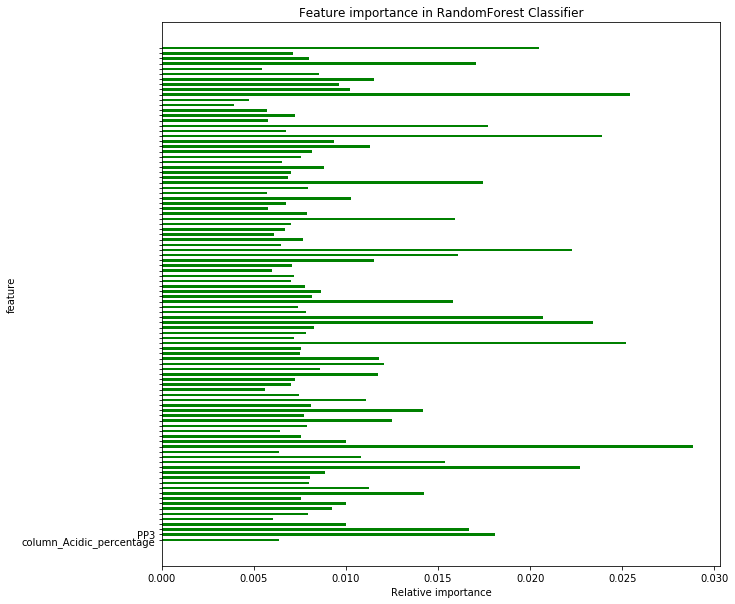

<Figure size 360x360 with 0 Axes>

In [40]:
col = x_selected

# model2.feature_importance_
y = model2.feature_importances_
#plot
fig, ax = plt.subplots() 
width = 0.5 # the width of the bars 
ind = np.arange(len(y)) # the x locations for the groups
ax.barh(ind, y, width, color="g")
ax.set_yticks(ind+width/20)
ax.set_yticklabels(col, minor=False)

plt.savefig("feature_imp.png")
plt.title("Feature importance in RandomForest Classifier")
plt.xlabel("Relative importance")
plt.ylabel("feature") 
plt.figure(figsize=(5,5))
fig.set_size_inches(10, 10, forward=True)

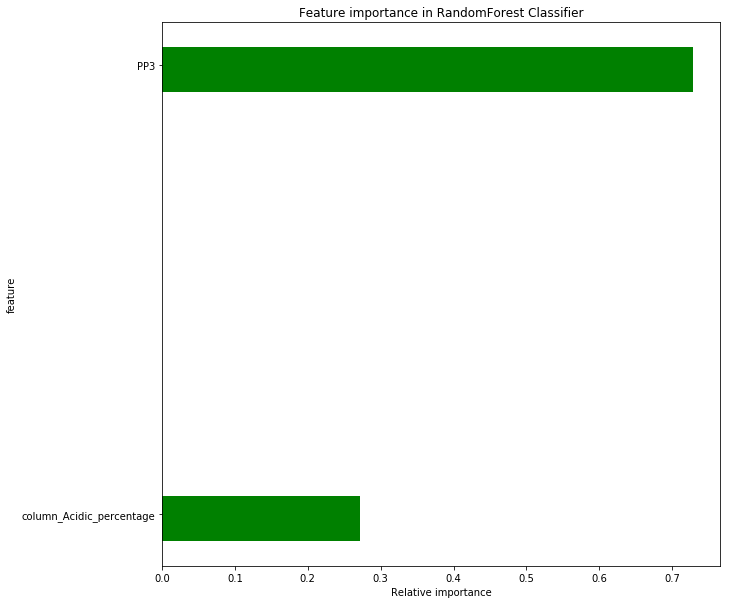

<Figure size 360x360 with 0 Axes>

In [41]:
col = x_selected

# model2.feature_importance_
y = model.feature_importances_
#plot
fig, ax = plt.subplots() 
width = 0.1 # the width of the bars 
ind = np.arange(len(y)) # the x locations for the groups
ax.barh(ind, y, width, color="g")
ax.set_yticks(ind+width/10)
ax.set_yticklabels(col, minor=False)

plt.savefig("feature_imp1.png")
plt.title("Feature importance in RandomForest Classifier")
plt.xlabel("Relative importance")
plt.ylabel("feature") 
plt.figure(figsize=(5,5))
fig.set_size_inches(10, 10, forward=True)

Feature ranking:
1. feature 18 (0.028870)
2. feature 86 (0.025407)
3. feature 38 (0.025189)
4. feature 78 (0.023911)
5. feature 42 (0.023408)
6. feature 14 (0.022704)
7. feature 56 (0.022252)
8. feature 43 (0.020696)
9. feature 95 (0.020495)
10. feature 1 (0.018116)
11. feature 80 (0.017737)
12. feature 69 (0.017449)
13. feature 92 (0.017086)
14. feature 2 (0.016690)
15. feature 55 (0.016071)
16. feature 62 (0.015899)
17. feature 46 (0.015812)
18. feature 15 (0.015360)
19. feature 9 (0.014237)
20. feature 25 (0.014195)
21. feature 23 (0.012522)
22. feature 34 (0.012053)
23. feature 35 (0.011809)
24. feature 32 (0.011733)
25. feature 54 (0.011541)
26. feature 89 (0.011517)
27. feature 76 (0.011298)
28. feature 10 (0.011241)
29. feature 27 (0.011111)
30. feature 16 (0.010832)
31. feature 66 (0.010282)
32. feature 87 (0.010198)
33. feature 19 (0.010010)
34. feature 3 (0.010008)
35. feature 7 (0.009974)
36. feature 88 (0.009641)
37. feature 77 (0.009335)
38. feature 6 (0.009245)
39. featur

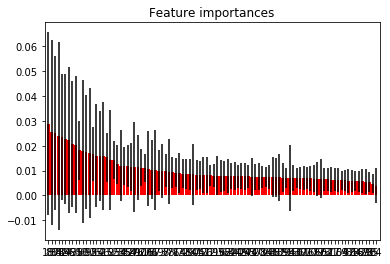

In [42]:
from sklearn.datasets import make_classification

importances = model2.feature_importances_
std = np.std([model2.feature_importances_ for model2 in model2.estimators_],
             axis=0)
indices = np.argsort(importances)[::-1]

# Print the feature ranking
print("Feature ranking:")

for f in range(X_train2.shape[1]):
    print("%d. feature %d (%f)" % (f + 1, indices[f], importances[indices[f]]))

# Plot the feature importances of the forest
plt.figure()
plt.title("Feature importances")
plt.bar(range(X_train2.shape[1]), importances[indices],  color="r", yerr=std[indices], align="center")
plt.xticks(range(X_train2.shape[1]), indices)
plt.xlim([-1, X_train2.shape[1]])
plt.show()



# considering all the features

In [43]:
rf_predictions2= model2.predict(X_test2)
rf_predictions2

array(['AMP', 'AMP', 'NAMP', ..., 'NAMP', 'AMP', 'AMP'], dtype=object)

In [44]:
rf_probs= model.predict_proba(X_test)[:,1]
rf_probs

array([0.07, 0.02, 0.08, ..., 0.95, 0.48, 0.04])

In [45]:
roc_value= roc_auc_score(y_test, rf_probs)
roc_value

0.8330675830400527

In [46]:
model2.predict_proba(X_test2)

array([[9.99e-01, 6.67e-04],
       [1.00e+00, 0.00e+00],
       [4.53e-01, 5.47e-01],
       ...,
       [1.30e-01, 8.70e-01],
       [8.61e-01, 1.39e-01],
       [9.94e-01, 6.33e-03]])

In [48]:
y_pred4= model2.predict(X_test2)
y_true4= y_test

results4= confusion_matrix(y_true4, y_pred4)

print(results4)

[[3115  194]
 [ 237  364]]


In [49]:
accuracy= accuracy_score(y_true4, y_pred4)
accuracy

0.889769820971867

In [50]:
# Extract single tree
# estimator = model.estimators_[5]

estimator2= model2.estimators_[0]

from sklearn.tree import export_graphviz
# Export as dot file
export_graphviz(estimator2, out_file='tree3.dot', 
                feature_names = x_cols,
                class_names =classes,
                rounded = True, proportion = False, 
                precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)
from subprocess import call
call(['dot', '-Tpng', 'tree3.dot', '-o', 'tree3.png', '-Gdpi=600'])

# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'tree3.png')

# SVM

In [51]:
from sklearn import svm

In [105]:
X= datafile[x_cols].values
Y= datafile[y_cols].values

X=np.nan_to_num(X)
y=np.nan_to_num(Y)

y=y.ravel()

X_train, X_test, y_train, y_test= train_test_split(X,y,random_state=0)
y_color= pd.factorize(y_train)[0]

In [91]:
clf= svm.SVC(kernel="linear", C=1)
clf.fit(X_train, y_color)


SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto_deprecated',
  kernel='linear', max_iter=-1, probability=False, random_state=None,
  shrinking=True, tol=0.001, verbose=False)

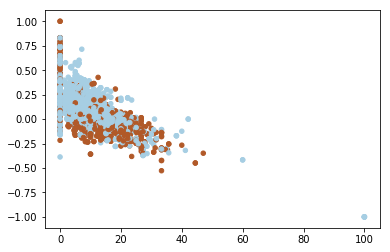

In [93]:
y_color= pd.factorize(y_train)[0]
plt.scatter(X_train[:,0], X_train[:,1], s=20, cmap=plt.cm.Paired, c= y_color)
plt.show()

In [94]:
pred= clf.predict(X_test)
pred

array([0, 0, 0, ..., 0, 0, 0])

In [97]:
print(clf.support_vectors_)
print(clf.support_)
print(clf.n_support_)

[[ 8.11e+00  4.04e-02]
 [ 0.00e+00 -1.35e-02]
 [ 2.22e+01 -1.97e-01]
 ...
 [ 1.00e+01 -1.95e-02]
 [ 5.00e+00  1.66e-01]
 [ 0.00e+00  8.75e-02]]
[    9    12    13 ... 11717 11718 11723]
[1876 1833]


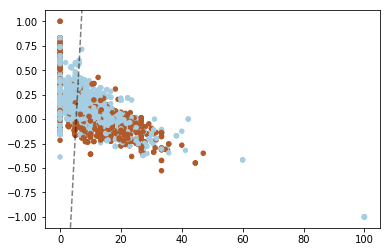

In [84]:
y_color= pd.factorize(y_train)[0]
plt.scatter(X_train[:,0], X_train[:,1], s=20, cmap=plt.cm.Paired, c= y_color)

ax= plt.gca()
xlim= ax.get_xlim()
ylim= ax.get_ylim()

xx= np.linspace(xlim[0], xlim[1], 30)
yy= np.linspace(ylim[0], ylim[1], 30)
YY,XX= np.meshgrid(yy,xx)
xy= np.vstack([XX.ravel(), YY.ravel()]).T
Z= clf.decision_function(xy).reshape(XX.shape)

ax.contour(XX, YY, Z, colors= "k", levels= [-1,0,1], 
          alpha= 0.5,
          linestyles= ["--", "-", "--"])

ax.scatter(clf.support_vectors_[:, 0],
          clf.support_vectors_[:,1], s=100,
          linewidth=1, facecolors= "none")
plt.show()

In [ ]:
print("Test set prediction: {}".format(clf.predict(X_test)))
print("Test set accuracy: {:.2f}". format(clf.score(X_test, y_test)))

In [106]:
y_true= y_test
y_pred= clf.predict(X_test)
accuracy_score(y_true, y_pred)

0.8488491048593351

In [113]:
x_selected= ["column_Acidic_percentage", "PP3", "aindex"]

In [114]:
X1= datafile[x_selected].values
Y1= datafile[y_cols].values

X1=np.nan_to_num(X1)
y1=np.nan_to_num(Y1)

y1=y1.ravel()

X_train1, X_test1, y_train1, y_test1= train_test_split(X1,y1,random_state=0)
y_color1= pd.factorize(y_train1)[0]
y_color1_test= pd.factorize(y_test1)[0]

In [112]:
y_true1= y_color1_test
y_pred1= clf.predict(X_test1)

accuracy_score(y_true1, y_pred1)

0.8462915601023018

In [ ]:

# The equation of the separating plane is given by all x in R^3 such that:
# np.dot(svc.coef_[0], x) + b = 0. We should solve for the last coordinate
# to plot the plane in terms of x and y.

z = lambda x,y: (-svc.intercept_[0]-svc.coef_[0][0]*x-svc.coef_[0][1]*y) / svc.coef_[0][2]

tmp = np.linspace(-2,2,51)
x,y = np.meshgrid(tmp,tmp)

# Plot stuff.
fig = plt.figure()
ax  = fig.add_subplot(111, projection='3d')
ax.plot_surface(x, y, z(x,y))
ax.plot3D(X[Y==0,0], X[Y==0,1], X[Y==0,2],'ob')
ax.plot3D(X[Y==1,0], X[Y==1,1], X[Y==1,2],'sr')
plt.show()